In [110]:
import pandas as pd
import geopandas as gpd
import matplotlib.pyplot as plt
#from pyproj import CRS
%matplotlib inline
import seaborn as sns
import numpy as np

import warnings
import logging
warnings.filterwarnings("ignore",category=DeprecationWarning)
logging.basicConfig(format='%(asctime)s : %(levelname)s : %(message)s', level=logging.ERROR)

In [52]:
zoopla = pd.read_csv('../Project/GlasgowData/GlasgowData.csv')
zoopla

,listing_id,property_id,property_type,start_date,end_date,price_first,price_last,price_min,price_max,price_unique,...,agent_name,agent_phone,agent_address,agent_postcode,image_caption,thumbnail_url,floor_plan,original_image,bullet,lad20nm
0,60565520,NaN,Flat,2022/1/20,2022/3/31,140,140,140,140,[140],...,"[""Staykeepers""]","[""020 3641 8895""]","[""78 Commercial Street, London""]","[""E1 6LY""]",[],"[""https://lid.zoocdn.com/80/60/e1bbc68d0e40008...",[],"[""https://lc.zoocdn.com/e1bbc68d0e40008bd4ffc0...",[],Glasgow City
1,60565521,NaN,Studio,2022/1/20,2022/3/31,177,177,177,177,[177],...,"[""Staykeepers""]","[""020 3641 8895""]","[""78 Commercial Street, London""]","[""E1 6LY""]",[],"[""https://lid.zoocdn.com/80/60/4d5ce41b2289b55...",[],"[""https://lc.zoocdn.com/4d5ce41b2289b552a8087b...",[],Glasgow City
2,60422041,NaN,Flat,2021/12/25,2022/1/20,194,194,194,194,[194],...,"[""DJ Alexander""]","[""0141 376 7835""]","[""DJ Alexander Lettings LTD, 60 Tradeston Stre...","[""G5 8BH""]",[],"[""https://lid.zoocdn.com/80/60/dc059baebe14806...","[""https://lc.zoocdn.com/12313ab10016f0c0c0fd95...","[""https://lc.zoocdn.com/2543d1189287ad7e448a97...","[""Central Heating"", ""Shared Garden"", ""Shower"",...",Glasgow City
3,60565522,NaN,Flat,2022/1/20,2022/3/31,147,147,147,147,[147],...,"[""Staykeepers""]","[""020 3641 8895""]","[""78 Commercial Street, London""]","[""E1 6LY""]",[],"[""https://lid.zoocdn.com/80/60/4d5ce41b2289b55...",[],"[""https://lc.zoocdn.com/4d5ce41b2289b552a8087b...",[],Glasgow City
4,60245623,NaN,Flat,2021/11/23,2021/11/25,173,173,173,173,[173],...,"[""OpenRent""]","[""020 3542 2178""]","[""Office 34, 67-68 Hatton Garden, London""]","[""EC1N 8JY""]",[],"[""https://lid.zoocdn.com/80/60/81f5a990962dcfb...",[],"[""https://lc.zoocdn.com/81f5a990962dcfb91d7614...","[""No Agent Fees"", ""Students Can Enquire"", ""Pro...",Glasgow City
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
13821,56745309,27585512.0,Flat,2020/10/28,2020/10/29,242,242,242,242,[242],...,"[""Slater Hogg & Howison - Candleriggs Lettings""]","[""0141 376 0217""]","[""123 Candleriggs, Glasgow""]","[""G1 1NP""]",[],"[""https://lid.zoocdn.com/80/60/38ad437425f0646...",[],"[""https://lc.zoocdn.com/38ad437425f06463e4bbbc...","[""Available now"", ""Furnished"", ""Private parkin...",Glasgow City
13822,56766673,9130818.0,Flat,2020/10/30,2020/10/30,288,288,288,288,[288],...,"[""1-4-Sale""]","[""0141 376 4425""]","[""104 Bellgrove Street, Glasgow""]","[""G31 1AA""]",[],"[""https://lid.zoocdn.com/80/60/fbc04a557487592...",[],"[""https://lc.zoocdn.com/fbc04a557487592546384d...","[""Large traditional property"", ""Delighful loun...",Glasgow City
13823,60318542,30732178.0,Cottage,2021/12/4,2021/12/21,167,167,167,167,[167],...,"[""Clyde Property, Helensburgh""]","[""01436 428980""]","[""22 West Princes Street, Helensburgh""]","[""G84 8TD""]",[],"[""https://lid.zoocdn.com/80/60/54e6032d8399372...","[""https://lc.zoocdn.com/cdba80613fea2c3f45391f...","[""https://lc.zoocdn.com/54e6032d8399372ba2c46f...",[],Argyll and Bute
13824,59450983,9540380.0,Detached house,2021/8/14,2021/8/26,196,196,196,196,[196],...,"[""Property Bureau (Helensburgh)""]","[""01436 653026""]","[""9 Colquhoun Street, Helensburgh""]","[""G84 8AN""]","[""Photo 1""]","[""https://lid.zoocdn.com/80/60/9f8f3f56ec5ea0b...",[],"[""https://lc.zoocdn.com/9f8f3f56ec5ea0bb9bddbd...",[],Argyll and Bute


In [53]:
len(zoopla)

13826

In [54]:
zoopla.shape

(13826, 51)

## Data cleaning

1. Delete data other than January 2021 to December 2021 

In [55]:
# Convert the date to datetime64
zoopla['start_date'] = pd.to_datetime(zoopla['start_date'], format='%Y-%m-%d')

# Filter data between two dates
zoopla1 = zoopla.loc[(zoopla['start_date'] >= '2021-1-1')
                     & (zoopla['start_date'] <= '2021-12-31')]

In [56]:
len(zoopla1)

8943

2. Delete data outside of Glasgow

In [57]:
map1 = gpd.read_file('../glasgowBoundaries/Community_Councils.shp')
#map1.plot()
#map1 = map1.to_crs(4326)
zoopla_point = gpd.GeoDataFrame(zoopla1, geometry=gpd.points_from_xy(zoopla1.lon, zoopla1.lat),crs=4326)
zoopla_point = zoopla_point.to_crs(27700)
zoopla2 = gpd.sjoin(zoopla_point, map1, predicate = 'within')

In [58]:
len(zoopla2)

7196

In [59]:
map1 = gpd.read_file('../glasgowBoundaries/Community_Councils.shp')
print(map1.crs)

EPSG:27700


In [60]:
zoopla_point.lon.value_counts().index.max()

55.86653

In [61]:
zoopla_point.lon.describe()

count    8943.000000
mean       -4.228691
std         1.425268
min        -4.865044
25%        -4.298927
50%        -4.271119
75%        -4.234908
max        55.866530
Name: lon, dtype: float64

In [62]:
zoopla_point = zoopla_point[-(zoopla_point['lon']>-2)]
zoopla_point.lon.describe()

count    8936.000000
mean       -4.263216
std         0.084957
min        -4.865044
25%        -4.298933
50%        -4.271188
75%        -4.235184
max        -3.942973
Name: lon, dtype: float64

([], [])

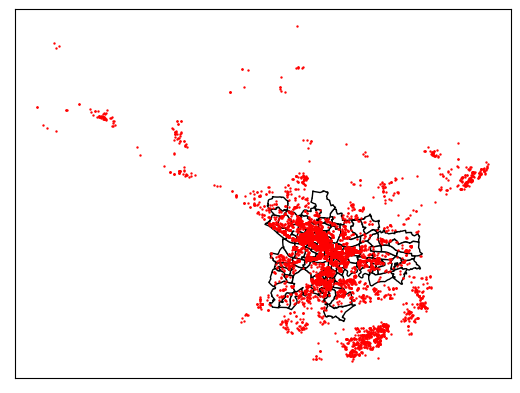

In [63]:
#before deleting
base = map1.plot(color='white', edgecolor='black')
zooplaf1=zoopla_point.plot(ax=base, marker='o', color='red', markersize=0.5)
plt.xticks([])
plt.yticks([])

([], [])

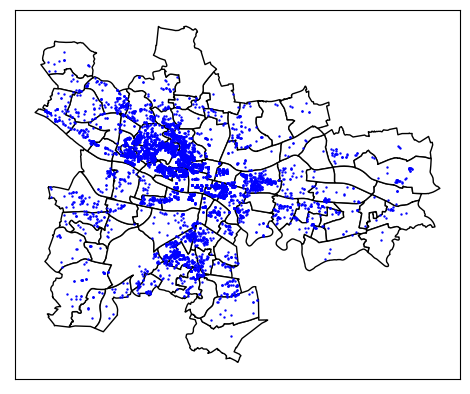

In [64]:
#after deleting
base = map1.plot(color='white', edgecolor='black')
zooplaf2=zoopla2.plot(ax=base, marker='o', color='blue', markersize=0.5)
plt.xticks([])
plt.yticks([])

EPSG:27700
EPSG:27700


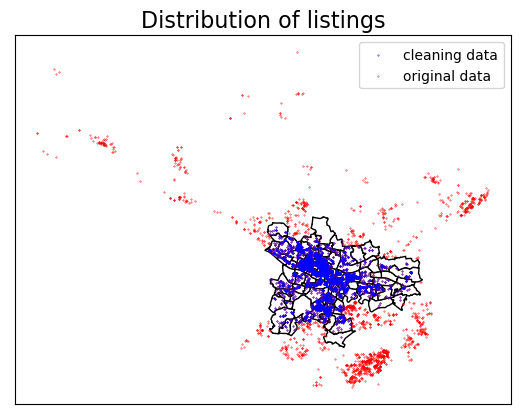

In [65]:
#comparison
boundary = gpd.read_file('../glasgowBoundaries/Community_Councils.shp')
#boundary.head()
print(boundary.crs)

zoopla_point = gpd.GeoDataFrame(zoopla1, geometry=gpd.points_from_xy(zoopla1.lon, zoopla1.lat),crs=4326)
zoopla_point = zoopla_point.to_crs(27700)
print(zoopla_point.crs)
zoopla2 = gpd.sjoin(zoopla_point, boundary, predicate = 'within')
zoopla3 = zoopla_point[-(zoopla_point['lon']>-2)]

#plot 
ax = zoopla2.plot(color = 'b', zorder=3, marker="o", markersize=.1)
ax1 = zoopla3.plot(ax = ax, color = 'r', zorder = 2, marker="o", markersize=.1)
boundary.plot(ax = ax1, color='w', edgecolor='k', zorder = 1)
ax.annotate("listings within Glasgow", xy=(-4.25,56.06),color='b',fontsize=7)
ax.annotate("Original data", xy=(-4.25,56.08),color='r',fontsize=7)
plt.title('Distribution of listings', fontsize=16)
plt.xticks([])
plt.yticks([])
plt.legend(['cleaning data','original data'],loc='upper right',labelcolor='black',fontsize=10)
plt.grid(True, alpha=0.5)
plt.savefig('GeoData.png',dpi=300)

In [66]:
zooplaf1.figure.savefig('Geo1.png', dpi=300)
zooplaf2.figure.savefig('Geo2.png', dpi=300)

3. Delete duplicate data by id (retain the latest end date data) 

In [67]:
zoopla2.sort_values('end_date').head()

,listing_id,property_id,property_type,start_date,end_date,price_first,price_last,price_min,price_max,price_unique,...,lad20nm,geometry,index_right,OBJECTID,CC_NAME,ACTIVE,URL,Shape_Leng,Shape_Area,Local_Auth
1962,57346451,NaN,Flat,2021-01-08,2021/1/10,201,201,201,201,[201],...,Glasgow City,POINT (258604.010 666219.053),80,81,Garnethill,Active,http://www.glasgow.gov.uk/index.aspx?articleid...,2263.190256,3.069252e+05,Glasgow City
1933,57326076,NaN,Flat,2021-01-06,2021/1/11,271,271,271,271,[271],...,Glasgow City,POINT (256839.013 667210.978),88,89,Hillhead,Active,http://www.glasgow.gov.uk/index.aspx?articleid...,3983.573473,8.421395e+05,Glasgow City
1971,57346926,NaN,Semi-detached house,2021-01-08,2021/1/11,343,343,343,343,[343],...,Glasgow City,POINT (255883.999 668667.920),54,55,Kelvindale,Active,http://www.glasgow.gov.uk/index.aspx?articleid...,6278.703452,1.840025e+06,Glasgow City
1917,57325598,NaN,Flat,2021-01-06,2021/1/11,162,162,162,162,[162],...,Glasgow City,POINT (257252.999 667676.256),36,37,North Kelvin,Active,http://www.glasgow.gov.uk/index.aspx?articleid...,5186.440221,9.410621e+05,Glasgow City
10840,57351321,27612683.0,Flat,2021-01-09,2021/1/11,179,179,179,179,[179],...,Glasgow City,POINT (259026.001 667210.080),4,5,Possilpark,Active,http://www.glasgow.gov.uk/index.aspx?articleid...,7059.787967,2.649673e+06,Glasgow City


In [68]:
zoopla3 = zoopla2[~zoopla2.listing_id.duplicated(keep = 'last')]

In [69]:
len(zoopla3)

7064

4. Delete data whose end date is earlier than the start date 

In [70]:
zoopla3['start_date'] = pd.to_datetime(zoopla3['start_date'])
zoopla3['end_date'] = pd.to_datetime(zoopla3['end_date'])
zoopla4 = zoopla3[~(zoopla3['start_date'] > zoopla3['end_date'])]
len(zoopla4)

/Users/yingxu/opt/anaconda3/lib/python3.9/site-packages/geopandas/geodataframe.py:1443: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  super().__setitem__(key, value)
/Users/yingxu/opt/anaconda3/lib/python3.9/site-packages/geopandas/geodataframe.py:1443: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  super().__setitem__(key, value)


7064

There is no data whose end date is earlier than the start date.

5. Delete null and non-English description data  

In [71]:
zoopla4['description'].isnull().values.any()

False

There is no null description data.

6. Delete data whose description is less than 2 percentile words long and more than 98 percentile words long 

In [72]:
zoopla4['word_count'] = zoopla4['description'].apply(lambda n: len(n.split()))
#zoopla6 = zoopla4.drop(zoopla4[zoopla4['word_count']<10].index)

#check the length of description value
#zoopla4['content_length'] = zoopla4['description'].str.len()
#zoopla4.content_length.describe()
#zoopla4['word_count'] = zoopla4.description.str.split(' ').str.len()
#limit word counts_2%
a = zoopla4['word_count'].quantile(0.02)
b = zoopla4['word_count'].quantile(1-0.02)

zoopla6 = zoopla4.loc[(zoopla4['word_count'] >= a) &(zoopla4['word_count'] <= b)]
#zoopla6 = zoopla4.drop('word_count', axis=1) 
#zoopla6 = zoopla4.drop('content_length', axis=1)
zoopla6['word_count'].describe()

count    6793.000000
mean      172.329898
std        88.586600
min        38.000000
25%        98.000000
50%       155.000000
75%       234.000000
max       438.000000
Name: word_count, dtype: float64

In [73]:
zoopla4['word_count'].describe()

count    7064.000000
mean      176.488250
std       101.516005
min         1.000000
25%        96.000000
50%       155.000000
75%       237.000000
max       829.000000
Name: word_count, dtype: float64

In [74]:
len(zoopla6)

6793

7. Delete the specific property types (according to the list of types of Airbnb and Zoopla)

In [75]:
zoopla7 = zoopla6.drop(zoopla6[zoopla6['property_type']=='Parking/garage'].index)

In [76]:
#clean attributes
#flat
zoopla7.loc[(zoopla7['property_type'] == 'Block of flats'),'property_type']= 'Flat'
#house
zoopla7.loc[(zoopla7['property_type'] == 'Town house') |
           (zoopla7['property_type'] == 'Detached house') |
           (zoopla7['property_type'] == 'End terrace house') |
           (zoopla7['property_type'] == 'Terraced house') |
           (zoopla7['property_type'] == 'Semi-detached house'),'property_type']= 'House'
#bungalow
zoopla7.loc[(zoopla7['property_type'] == 'Semi-detached bungalow') |
           (zoopla7['property_type'] == 'Terraced bungalow'),'property_type']= 'Bungalow'
#mews house
zoopla7 = zoopla7.drop(zoopla7[zoopla7['property_type']=='Mews house'].index)

In [77]:
zoopla6.property_type.value_counts()

Flat                      6355
Studio                     137
Terraced house              88
Semi-detached house         63
Maisonette                  32
Detached house              23
End terrace house           20
Cottage                     17
Town house                  15
Parking/garage              10
Bungalow                     4
Mews house                   3
Block of flats               2
Semi-detached bungalow       2
Terraced bungalow            1
Name: property_type, dtype: int64

In [78]:
zoopla7.property_type.value_counts()

Flat          6357
House          209
Studio         137
Maisonette      32
Cottage         17
Bungalow         7
Name: property_type, dtype: int64

In [79]:
len(zoopla7)

6780

8. Classify property types according to the content of the description and delete data that is not classified, if ‘property type’ is null 

In [80]:
type_na = zoopla7[zoopla7['property_type'].isna()]

In [81]:
#flat
blank_flat = type_na.loc[type_na['description'].str.contains("apartment")]
zoopla7.loc[(zoopla7['listing_id']==53751835) |
           (zoopla7['listing_id']==52544615) |
           (zoopla7['listing_id']==52155873),'property_type'] = 'Flat'

#cottage
blank_cottage = type_na.loc[type_na['description'].str.contains('cottage')]
zoopla7.loc[(zoopla7['listing_id']==59034661),'property_type'] = 'Cottage'

#House
blank_house = type_na.loc[type_na['description'].str.contains("house")]
zoopla7.loc[(zoopla7['listing_id']==57701108) |
           (zoopla7['listing_id']==60123542) |
           (zoopla7['listing_id']==52590769),'property_type'] = 'House'

#other
type_na = zoopla7[zoopla7['property_type'].isna()]
blank_garden = type_na.loc[type_na['description'].str.contains("garden")]
zoopla7.loc[(zoopla7['listing_id']==56835370) |
           (zoopla7['listing_id']==57879223) |
           (zoopla7['listing_id']==58304784) |
           (zoopla7['listing_id']==59244164) |
           (zoopla7['listing_id']==59594206) |
           (zoopla7['listing_id']==60261720),'property_type'] = 'House'

#drop other nan
zoopla8 = zoopla7[zoopla7['property_type'].notna()]

In [82]:
zoopla7.property_type.value_counts()

Flat          6360
House          217
Studio         137
Maisonette      32
Cottage         18
Bungalow         7
Name: property_type, dtype: int64

In [83]:
len(zoopla8)

6771

9. Delete the data where the value in the 'bedroom' column is null and set 0 to 1 in the 'bedroom' column

In [85]:
zoopla8['num_bed_min'].isnull().values.any()

False

There is no null data in the 'bedroom' column.

In [86]:
zoopla9 = zoopla8
zoopla9['num_bed_min'] = zoopla9['num_bed_min'].replace(['0'],'1')

/Users/yingxu/opt/anaconda3/lib/python3.9/site-packages/geopandas/geodataframe.py:1443: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  super().__setitem__(key, value)


In [87]:
len(zoopla9)

6771

In [88]:
zoopla9.to_csv("../Final/ZooplaGLA.csv", index=False)

# LDA

In [122]:
import sys
import re
# !{sys.executable} -m spacy download en
from pprint import pprint

# Gensim
import gensim, spacy, logging, warnings
import gensim.corpora as corpora
from gensim.utils import simple_preprocess
#from gensim.utils import lemmatize
from gensim.models import CoherenceModel
import matplotlib.pyplot as plt
import en_core_web_sm  #from spacy

# NLTK Stop words
from nltk.corpus import stopwords
stop_words = stopwords.words('english')
stop_words.extend(['from', 'subject', 're', 'edu', 'use', 'not', 'would', 'say', 'could', '_', 'be', 'know', 'good', 'go', 'get', 'do', 'done', 'try', 'many', 'some', 'nice', 'thank', 'think', 'see', 'rather', 'easy', 'easily', 'lot', 'lack', 'make', 'want', 'seem', 'run', 'need', 'even', 'right', 'line', 'even', 'also', 'may', 'take', 'come'])
from spacy.lang.en import English

import seaborn as sns
import matplotlib.colors as mcolors

1. import dataset

In [112]:
zoopla = pd.read_csv('../cleaned data_zoopla.csv')
zoopla.head()

,listing_id,property_id,property_type,start_date,end_date,price_first,price_last,price_min,price_max,price_unique,...,TYPE_CODE,DESCRIPT0,TYPE_COD0,DESCRIPT1,Council,FILE_NAM_1,Pop,Density,response,word_count
0,60422041,NaN,Flat,2021-12-25,2022-01-20,194,194,194,194,[194],...,AA,CIVIL ADMINISTRATION AREA,NaN,NaN,Glasgow City,GLASGOW_CITY,593000.0,3394.865101,89.0,174
1,60245623,NaN,Flat,2021-11-23,2021-11-25,173,173,173,173,[173],...,AA,CIVIL ADMINISTRATION AREA,NaN,NaN,Glasgow City,GLASGOW_CITY,593000.0,3394.865101,89.0,311
2,59386273,NaN,Flat,2021-08-06,2021-08-07,276,276,276,276,[276],...,AA,CIVIL ADMINISTRATION AREA,NaN,NaN,Glasgow City,GLASGOW_CITY,593000.0,3394.865101,89.0,367
3,58408991,NaN,Flat,2021-04-27,2021-07-28,196,225,196,225,"[196, 225]",...,AA,CIVIL ADMINISTRATION AREA,NaN,NaN,Glasgow City,GLASGOW_CITY,593000.0,3394.865101,89.0,193
4,58460581,NaN,Flat,2021-05-01,2021-05-20,207,207,207,207,[207],...,AA,CIVIL ADMINISTRATION AREA,NaN,NaN,Glasgow City,GLASGOW_CITY,593000.0,3394.865101,89.0,374


2. Tokenize Sentences and Clean

In [113]:
def sent_to_words(sentences):
    for sent in sentences:
        sent = re.sub('\S*@\S*\s?', '', sent)  # remove emails
        sent = re.sub('\s+', ' ', sent)  # remove newline chars
        sent = re.sub("\'", "", sent)  # remove single quotes
        sent = gensim.utils.simple_preprocess(str(sent), deacc=True) 
        yield(sent)  

# Convert to list
data = zoopla.description.values.tolist()
data_words = list(sent_to_words(data))
print(data_words[:1])

[['deposit', 'dj', 'alexander', 'present', 'to', 'the', 'market', 'this', 'traditional', 'one', 'bedroom', 'tenement', 'flat', 'in', 'the', 'highly', 'sought', 'after', 'hyndland', 'area', 'of', 'the', 'west', 'end', 'available', 'th', 'january', 'unfurnished', 'the', 'second', 'floor', 'property', 'consists', 'of', 'entrance', 'hallway', 'with', 'ample', 'storage', 'spacious', 'dual', 'aspect', 'lounge', 'offering', 'views', 'overlooking', 'hayburn', 'park', 'one', 'double', 'bedroom', 'fully', 'fitted', 'dining', 'kitchen', 'and', 'family', 'bathroom', 'with', 'shower', 'over', 'further', 'benefits', 'include', 'gch', 'secure', 'entry', 'system', 'and', 'permit', 'parking', 'situated', 'in', 'the', 'heart', 'of', 'hyndland', 'the', 'property', 'enjoys', 'excellent', 'access', 'to', 'numerous', 'west', 'end', 'amenities', 'including', 'glasgow', 'university', 'botanic', 'gardens', 'and', 'kelvingrove', 'park', 'and', 'is', 'ideally', 'located', 'to', 'take', 'advantage', 'of', 'wide',

3. Build the Bigram, Trigram Models and Lemmatize

In [114]:
# Build the bigram and trigram models
bigram = gensim.models.Phrases(data_words, min_count=5, threshold=100) # higher threshold fewer phrases.
trigram = gensim.models.Phrases(bigram[data_words], threshold=100)  
bigram_mod = gensim.models.phrases.Phraser(bigram)
trigram_mod = gensim.models.phrases.Phraser(trigram)

print(trigram_mod[bigram_mod[data_words[0]]])

['deposit_dj_alexander', 'present', 'to', 'the', 'market', 'this', 'traditional', 'one', 'bedroom', 'tenement', 'flat', 'in', 'the', 'highly_sought_after', 'hyndland', 'area', 'of', 'the', 'west', 'end', 'available', 'th', 'january', 'unfurnished', 'the', 'second', 'floor', 'property', 'consists', 'of', 'entrance', 'hallway', 'with', 'ample', 'storage', 'spacious', 'dual_aspect', 'lounge', 'offering', 'views', 'overlooking', 'hayburn', 'park', 'one', 'double', 'bedroom', 'fully', 'fitted', 'dining', 'kitchen', 'and', 'family', 'bathroom', 'with', 'shower', 'over', 'further', 'benefits', 'include', 'gch', 'secure', 'entry', 'system', 'and', 'permit', 'parking', 'situated', 'in', 'the', 'heart', 'of', 'hyndland', 'the', 'property', 'enjoys', 'excellent', 'access', 'to', 'numerous', 'west', 'end', 'amenities', 'including', 'glasgow', 'university', 'botanic', 'gardens', 'and', 'kelvingrove', 'park', 'and', 'is', 'ideally', 'located', 'to', 'take_advantage', 'of', 'wide', 'selection', 'of',

In [115]:
def process_words(texts, stop_words=stop_words, allowed_postags=['NOUN', 'ADJ', 'VERB', 'ADV']):
    """Remove Stopwords, Form Bigrams, Trigrams and Lemmatization"""
    texts = [[word for word in simple_preprocess(str(doc)) if word not in stop_words] for doc in texts]
    texts = [bigram_mod[doc] for doc in texts]
    texts = [trigram_mod[bigram_mod[doc]] for doc in texts]
    texts_out = []
    #nlp = spacy.load('en', disable=['parser', 'ner'])
    nlp = spacy.load('en_core_web_sm')
    for sent in texts:
        doc = nlp(" ".join(sent)) 
        texts_out.append([token.lemma_ for token in doc if token.pos_ in allowed_postags])
    # remove stopwords once more after lemmatization
    texts_out = [[word for word in simple_preprocess(str(doc)) if word not in stop_words] for doc in texts_out]    
    return texts_out

data_ready = process_words(data_words)  # processed Text Data!
print(data_ready[:1])

[['present', 'market', 'traditional', 'bedroom', 'tenement', 'flat', 'highly', 'seek', 'area', 'available', 'unfurnished', 'second', 'floor', 'property', 'consist', 'entrance', 'ample', 'storage', 'spacious', 'dual_aspect', 'lounge', 'offering', 'view', 'overlook', 'hayburn', 'park', 'double', 'bedroom', 'fully', 'fit', 'dining', 'kitchen', 'family', 'bathroom', 'benefit', 'include', 'gch', 'secure', 'entry', 'system', 'permit', 'parking', 'situate', 'heart', 'property', 'enjoy', 'excellent', 'access', 'numerous', 'end', 'amenity', 'include', 'glasgow', 'botanic', 'garden', 'kelvingrove', 'park', 'ideally', 'locate', 'advantage', 'wide', 'selection', 'independent', 'shop', 'boutique', 'bar', 'road', 'clarence_drive', 'ample', 'public', 'transport', 'link', 'centre', 'situate', 'short', 'walk', 'property', 'include', 'hyndland', 'train', 'station', 'property', 'minute', 'drive', 'motorway', 'ensure', 'access', 'scotland', 'arterial', 'road', 'network', 'landlord', 'registration', 'scott

4. Build the Topic Model

In [116]:
# Create Dictionary
id2word = corpora.Dictionary(data_ready)

# Create Corpus: Term Document Frequency
corpus = [id2word.doc2bow(text) for text in data_ready]

# Build LDA model
lda_model = gensim.models.ldamodel.LdaModel(corpus=corpus,
                                           id2word=id2word,
                                           num_topics=6, 
                                           random_state=100,
                                           update_every=1,
                                           chunksize=10,
                                           passes=10,
                                           alpha='symmetric',
                                           iterations=100,
                                           per_word_topics=True)

pprint(lda_model.print_topics())

[(0,
  '0.051*"property" + 0.039*"information" + 0.032*"available" + '
  '0.025*"contact" + 0.023*"number" + 0.023*"landlord" + 0.022*"reference" + '
  '0.021*"pet" + 0.020*"view" + 0.020*"fee"'),
 (1,
  '0.040*"bedroom" + 0.034*"double" + 0.028*"property" + 0.028*"registration" '
  '+ 0.021*"fit" + 0.021*"kitchen" + 0.020*"lounge" + 0.020*"bathroom" + '
  '0.017*"heating" + 0.016*"landlord"'),
 (2,
  '0.043*"city" + 0.039*"glasgow" + 0.036*"property" + 0.029*"centre" + '
  '0.027*"area" + 0.025*"access" + 0.024*"restaurant" + 0.023*"distance" + '
  '0.022*"locate" + 0.021*"bus"'),
 (3,
  '0.032*"property" + 0.031*"new" + 0.029*"student" + 0.026*"note" + '
  '0.025*"provide" + 0.021*"glasgow" + 0.021*"view" + 0.021*"offer" + '
  '0.020*"university" + 0.018*"luxury"'),
 (4,
  '0.018*"space" + 0.018*"include" + 0.018*"well" + 0.018*"feature" + '
  '0.017*"access" + 0.014*"fridge" + 0.014*"floor" + 0.014*"suite" + '
  '0.013*"apartment" + 0.013*"storage"'),
 (5,
  '0.061*"road" + 0.033*"s

5. Dominant topic and its percentage contribution in each document

In [117]:
def format_topics_sentences(ldamodel=None, corpus=corpus, texts=data):
    # Init output
    sent_topics_df = pd.DataFrame()

    # Get main topic in each document
    for i, row_list in enumerate(ldamodel[corpus]):
        row = row_list[0] if ldamodel.per_word_topics else row_list            
        # print(row)
        row = sorted(row, key=lambda x: (x[1]), reverse=True)
        # Get the Dominant topic, Perc Contribution and Keywords for each document
        for j, (topic_num, prop_topic) in enumerate(row):
            if j == 0:  # => dominant topic
                wp = ldamodel.show_topic(topic_num)
                topic_keywords = ", ".join([word for word, prop in wp])
                sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
            else:
                break
    sent_topics_df.columns = ['Dominant_Topic', 'Perc_Contribution', 'Topic_Keywords']

    # Add original text to the end of the output
    contents = pd.Series(texts)
    sent_topics_df = pd.concat([sent_topics_df, contents], axis=1)
    return(sent_topics_df)


df_topic_sents_keywords = format_topics_sentences(ldamodel=lda_model, corpus=corpus, texts=data_ready)

# Format
df_dominant_topic = df_topic_sents_keywords.reset_index()
df_dominant_topic.columns = ['Document_No', 'Dominant_Topic', 'Topic_Perc_Contrib', 'Keywords', 'Text']

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/60401639.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/60401639.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/60401639.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ig

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/60401639.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/60401639.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/60401639.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ig

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/60401639.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/60401639.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/60401639.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ig

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/60401639.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/60401639.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/60401639.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ig

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/60401639.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/60401639.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/60401639.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ig

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/60401639.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/60401639.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/60401639.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ig

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/60401639.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/60401639.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/60401639.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ig

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/60401639.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/60401639.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/60401639.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ig

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/60401639.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/60401639.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/60401639.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ig

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/60401639.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/60401639.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/60401639.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ig

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/60401639.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/60401639.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/60401639.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ig

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/60401639.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/60401639.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/60401639.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ig

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/60401639.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/60401639.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/60401639.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ig

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/60401639.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/60401639.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/60401639.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ig

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/60401639.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/60401639.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/60401639.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ig

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/60401639.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/60401639.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/60401639.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ig

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/60401639.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/60401639.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/60401639.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ig

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/60401639.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/60401639.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/60401639.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ig

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/60401639.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/60401639.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/60401639.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ig

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/60401639.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/60401639.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/60401639.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ig

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/60401639.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/60401639.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/60401639.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ig

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/60401639.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/60401639.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/60401639.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ig

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/60401639.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/60401639.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/60401639.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ig

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/60401639.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/60401639.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/60401639.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ig

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/60401639.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/60401639.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/60401639.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ig

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/60401639.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/60401639.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/60401639.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ig

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/60401639.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/60401639.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/60401639.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ig

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/60401639.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/60401639.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/60401639.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ig

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/60401639.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/60401639.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/60401639.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ig

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/60401639.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/60401639.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/60401639.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ig

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/60401639.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/60401639.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/60401639.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ig

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/60401639.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/60401639.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/60401639.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ig

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/60401639.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/60401639.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/60401639.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ig

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/60401639.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/60401639.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/60401639.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ig

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/60401639.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/60401639.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/60401639.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ig

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/60401639.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/60401639.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/60401639.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ig

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/60401639.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/60401639.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/60401639.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ig

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/60401639.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/60401639.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/60401639.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ig

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/60401639.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/60401639.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/60401639.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ig

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/60401639.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/60401639.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/60401639.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ig

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/60401639.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/60401639.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/60401639.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ig

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/60401639.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/60401639.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/60401639.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ig

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/60401639.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/60401639.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/60401639.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ig

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/60401639.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/60401639.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/60401639.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ig

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/60401639.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/60401639.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/60401639.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ig

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/60401639.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/60401639.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/60401639.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ig

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/60401639.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/60401639.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/60401639.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ig

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/60401639.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/60401639.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/60401639.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ig

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/60401639.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/60401639.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/60401639.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ig

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/60401639.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/60401639.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/60401639.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ig

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/60401639.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/60401639.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/60401639.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ig

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/60401639.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/60401639.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/60401639.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ig

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/60401639.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/60401639.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/60401639.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ig

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/60401639.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/60401639.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/60401639.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ig

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/60401639.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/60401639.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/60401639.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ig

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/60401639.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/60401639.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/60401639.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ig

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/60401639.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/60401639.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/60401639.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ig

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/60401639.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/60401639.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/60401639.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ig

In [118]:
df_dominant_topic.head(10)

,Document_No,Dominant_Topic,Topic_Perc_Contrib,Keywords,Text
0,0,1,0.5160,"bedroom, double, property, registration, fit, ...","[present, market, traditional, bedroom, teneme..."
1,1,0,0.5895,"property, information, available, contact, num...","[property, reference, note, viewing, available..."
2,2,0,0.6792,"property, information, available, contact, num...","[property, reference, offer, delightful, bedro..."
3,3,0,0.8687,"property, information, available, contact, num...","[property, reference, mount_florida, super, po..."
4,4,0,0.4401,"property, information, available, contact, num...","[property, reference, spacious, fourth, floor,..."
5,5,0,0.6665,"property, information, available, contact, num...","[property, reference, bill, include, price, ex..."
6,6,1,0.4287,"bedroom, double, property, registration, fit, ...","[tay, let, delighted, bring, market, beautiful..."
7,7,1,0.3417,"bedroom, double, property, registration, fit, ...","[tay, let, delighted, present, market, sensati..."
8,8,5,0.4530,"road, sized, minute, walk, end, property, incl...","[tay, let, delighted, bring, market, exception..."
9,9,1,0.5421,"bedroom, double, property, registration, fit, ...","[available, furnished, bedroom, apartment, exc..."


6. The most representative sentence for each topic

In [119]:
# Display setting to show more characters in column
pd.options.display.max_colwidth = 100

sent_topics_sorteddf_mallet = pd.DataFrame()
sent_topics_outdf_grpd = df_topic_sents_keywords.groupby('Dominant_Topic')

for i, grp in sent_topics_outdf_grpd:
    sent_topics_sorteddf_mallet = pd.concat([sent_topics_sorteddf_mallet, 
                                             grp.sort_values(['Perc_Contribution'], ascending=False).head(1)], 
                                            axis=0)

# Reset Index    
sent_topics_sorteddf_mallet.reset_index(drop=True, inplace=True)

# Format
sent_topics_sorteddf_mallet.columns = ['Topic_Num', "Topic_Perc_Contrib", "Keywords", "Representative Text"]

# Show
sent_topics_sorteddf_mallet.head(10)

,Topic_Num,Topic_Perc_Contrib,Keywords,Representative Text
0,0,0.9939,"property, information, available, contact, number, landlord, reference, pet, view, fee","[property, reference, offer, delightful, bedroom, bathroom, flat, great, location, available, mo..."
1,1,0.9842,"bedroom, double, property, registration, fit, kitchen, lounge, bathroom, heating, landlord","[available, delighted, introduce, well, present, bedroom, furnish, apartment, city, south, side,..."
2,2,0.6330,"city, glasgow, property, centre, area, access, restaurant, distance, locate, bus","[area, serve, public, transport, link, mile, walk, glasgow, central, rail, station, underground,..."
3,3,0.5253,"property, new, student, note, provide, glasgow, view, offer, university, luxury","[student, group, booking, available, buchanan, view, perfect, place, affordable, city, living, s..."
4,4,0.5742,"space, include, well, feature, access, fridge, floor, suite, apartment, storage","[property, steep, historic, traditional, feature, rarely, available, newly, modernise, quality, ..."
5,5,0.6695,"road, sized, minute, walk, end, property, include, station, byre, shop","[property, comprise, single, room, house, double, bed, sofa, fit, kitchen, share, bathroom, piec..."


7. Frequency Distribution of Word Counts in Documents

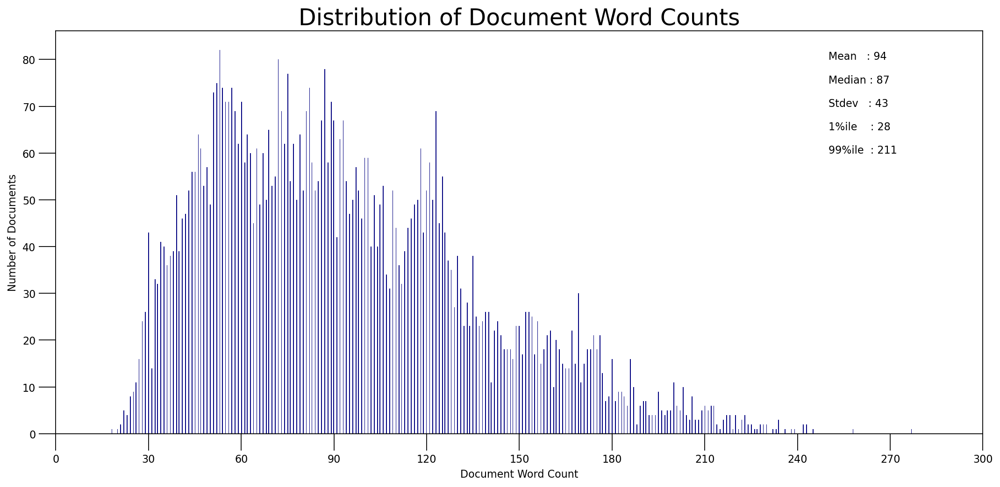

In [120]:
doc_lens = [len(d) for d in df_dominant_topic.Text]

# Plot
plt.figure(figsize=(16,7), dpi=160)
plt.hist(doc_lens, bins = 1000, color='navy')
plt.text(250, 80, "Mean   : " + str(round(np.mean(doc_lens))))
plt.text(250, 75, "Median : " + str(round(np.median(doc_lens))))
plt.text(250, 70, "Stdev   : " + str(round(np.std(doc_lens))))
plt.text(250, 65, "1%ile    : " + str(round(np.quantile(doc_lens, q=0.01))))
plt.text(250, 60, "99%ile  : " + str(round(np.quantile(doc_lens, q=0.99))))

plt.gca().set(xlim=(0, 300), ylabel='Number of Documents', xlabel='Document Word Count')
plt.tick_params(size=16)
plt.xticks(np.linspace(0,300,11))
plt.title('Distribution of Document Word Counts', fontdict=dict(size=22))
plt.show()

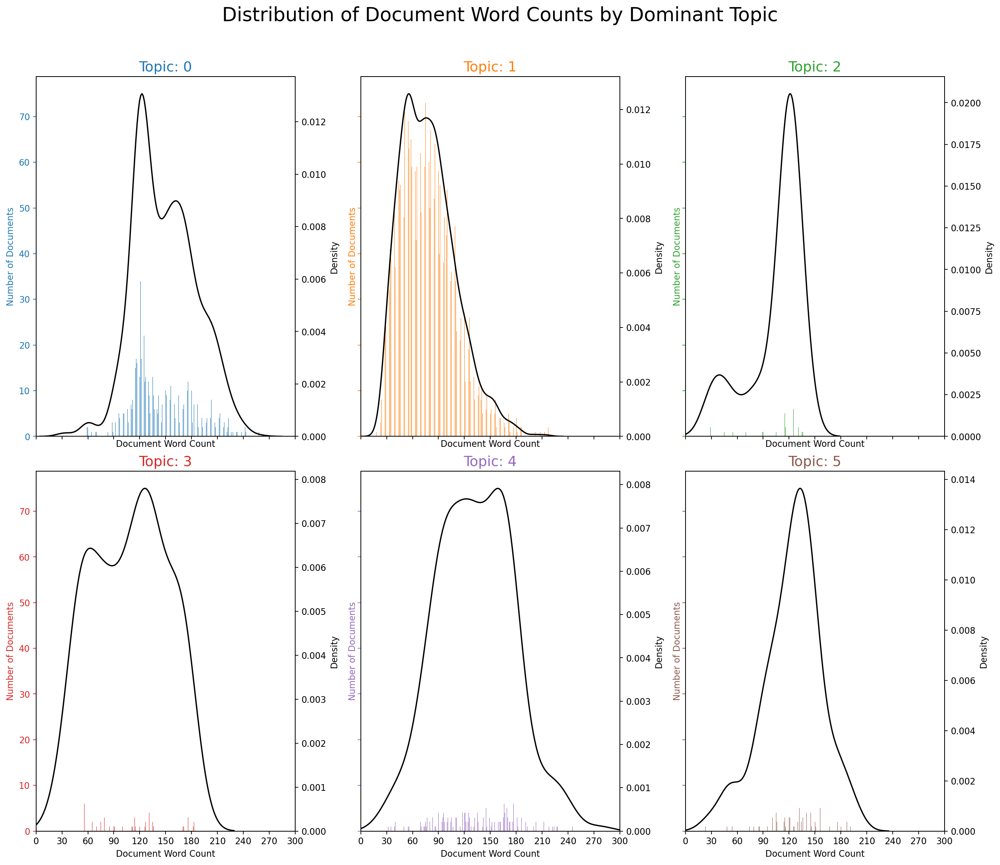

In [123]:
cols = [color for name, color in mcolors.TABLEAU_COLORS.items()]  # more colors: 'mcolors.XKCD_COLORS'

fig, axes = plt.subplots(2,3,figsize=(16,14), dpi=160, sharex=True, sharey=True)

for i, ax in enumerate(axes.flatten()):    
    df_dominant_topic_sub = df_dominant_topic.loc[df_dominant_topic.Dominant_Topic == i, :]
    doc_lens = [len(d) for d in df_dominant_topic_sub.Text]
    ax.hist(doc_lens, bins = 1000, color=cols[i])
    ax.tick_params(axis='y', labelcolor=cols[i], color=cols[i])
    sns.kdeplot(doc_lens, color="black", shade=False, ax=ax.twinx())
    ax.set(xlim=(0, 300), xlabel='Document Word Count')
    ax.set_ylabel('Number of Documents', color=cols[i])
    ax.set_title('Topic: '+str(i), fontdict=dict(size=16, color=cols[i]))

fig.tight_layout()
fig.subplots_adjust(top=0.90)
plt.xticks(np.linspace(0,300,11))
fig.suptitle('Distribution of Document Word Counts by Dominant Topic', fontsize=22)
plt.show()

8. Word Clouds of Top N Keywords in Each Topic

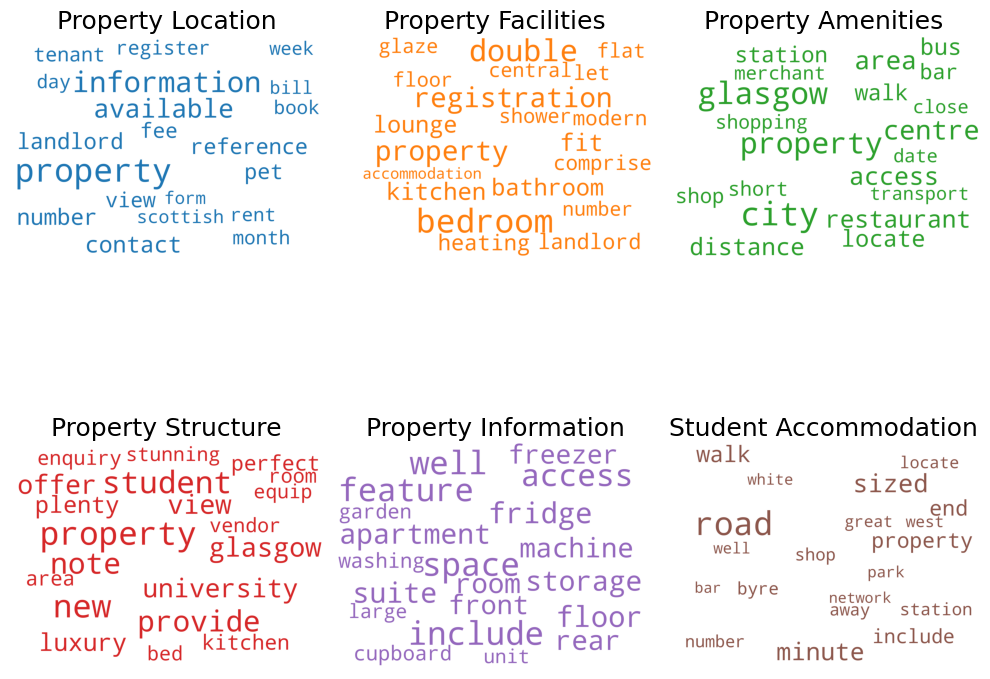

In [124]:
# Wordcloud of Top N words in each topic
from matplotlib import pyplot as plt
from wordcloud import WordCloud, STOPWORDS
import matplotlib.colors as mcolors

cols = [color for name, color in mcolors.TABLEAU_COLORS.items()]  # more colors: 'mcolors.XKCD_COLORS'

cloud = WordCloud(stopwords=stop_words,
                  background_color='white',
                  width=2500,
                  height=1800,
                  max_words=20,
                  colormap='tab10',
                  color_func=lambda *args, **kwargs: cols[i],
                  prefer_horizontal=1.0)

topics = lda_model.show_topics(formatted=False,num_words=25)

fig, axes = plt.subplots(2, 3, figsize=(10,10), sharex=True, sharey=True)

for i, ax in enumerate(axes.flatten()):
    fig.add_subplot(ax)
    topic_words = dict(topics[i][1])
    cloud.generate_from_frequencies(topic_words, max_font_size=260)
    plt.gca().imshow(cloud)
    #plt.gca().set_title('Topic ' + str(i))
    plt.gca().axis('off')
    ax1 = plt.subplot(231)
    ax1.set_title('Property Location', fontdict=dict(size=18))
    ax2 = plt.subplot(232)
    ax2.set_title('Property Facilities', fontdict=dict(size=18))
    ax3 = plt.subplot(233)
    ax3.set_title('Property Amenities', fontdict=dict(size=18))
    ax4 = plt.subplot(234)
    ax4.set_title('Property Structure', fontdict=dict(size=18))
    ax5 = plt.subplot(235)
    ax5.set_title('Property Information', fontdict=dict(size=18))
    ax6 = plt.subplot(236)
    ax6.set_title('Student Accommodation', fontdict=dict(size=18))


plt.subplots_adjust(wspace=0, hspace=0)
plt.axis('off')
plt.margins(x=0, y=0)
plt.tight_layout()
plt.savefig('wordcloud.png',dpi=450)
plt.show()

9. Word Counts of Topic Keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/2124024466.py:31: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(df.loc[df.topic_id==o[i], 'word'], rotation=30, horizontalalignment= 'right')


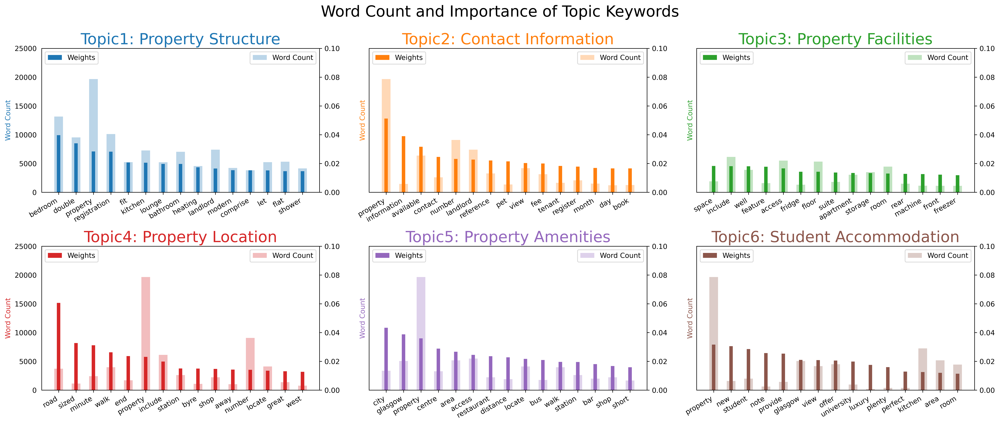

In [136]:
# Visualization
from collections import Counter
import matplotlib.colors as mcolors
topics = lda_model.show_topics(formatted=False,num_words=15)
data_flat = [w for w_list in data_ready for w in w_list]
counter = Counter(data_flat)

out = []
for i, topic in topics:
    for word, weight in topic:
        out.append([word, i , weight, counter[word]])

df = pd.DataFrame(out, columns=['word', 'topic_id', 'importance', 'word_count'])        

# Plot Word Count and Weights of Topic Keywords
fig, axes = plt.subplots(2, 3, figsize=(20,8), sharey=True, dpi=450)
cols = [color for name, color in mcolors.TABLEAU_COLORS.items()]
subtitle = ['Contact Information','Property Structure','Property Amenities','Student Accommodation','Property Facilities','Property Location']

# Adjust the topic order
o = [1,0,4,5,2,3]

for i, ax in enumerate(axes.flatten()):
    ax.bar(x='word', height="word_count", data=df.loc[df.topic_id==o[i], :], color=cols[i], width=0.5, alpha=0.3, label='Word Count')
    ax_twin = ax.twinx()
    ax_twin.bar(x='word', height="importance", data=df.loc[df.topic_id==o[i], :], color=cols[i], width=0.2, label='Weights')
    ax.set_ylabel('Word Count', color=cols[i])
    ax_twin.set_ylim(0, 0.10); ax.set_ylim(0, 25000)
    ax.set_title('Topic' +str(i+1)+': '+ subtitle[(o[i])], color=cols[i], fontsize=22)
    ax.tick_params(axis='y', left=False)
    ax.set_xticklabels(df.loc[df.topic_id==o[i], 'word'], rotation=30, horizontalalignment= 'right')
    ax.legend(loc='upper right'); ax_twin.legend(loc='upper left')

fig.tight_layout(w_pad=2)    
fig.suptitle('Word Count and Importance of Topic Keywords', fontsize=22, y=1.05) 
plt.savefig('Word Count and Importance of Topic Keywords_Zoopla.png',dpi=450)

10. Sentence Chart Colored by Topic

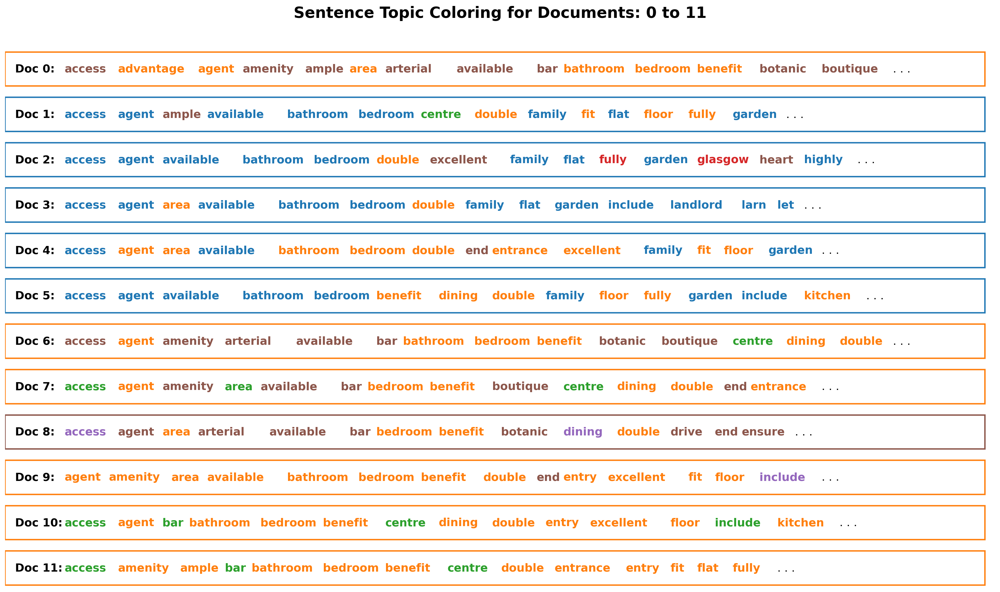

In [126]:
# Sentence Coloring of N Sentences
from matplotlib.patches import Rectangle

def sentences_chart(lda_model=lda_model, corpus=corpus, start = 0, end = 13):
    corp = corpus[start:end]
    mycolors = [color for name, color in mcolors.TABLEAU_COLORS.items()]

    fig, axes = plt.subplots(end-start, 1, figsize=(20, (end-start)*0.95), dpi=160)       
    axes[0].axis('off')
    for i, ax in enumerate(axes):
        if i > 0:
            corp_cur = corp[i-1] 
            topic_percs, wordid_topics, wordid_phivalues = lda_model[corp_cur]
            word_dominanttopic = [(lda_model.id2word[wd], topic[0]) for wd, topic in wordid_topics]    
            ax.text(0.01, 0.5, "Doc " + str(i-1) + ": ", verticalalignment='center',
                    fontsize=16, color='black', transform=ax.transAxes, fontweight=700)

            # Draw Rectange
            topic_percs_sorted = sorted(topic_percs, key=lambda x: (x[1]), reverse=True)
            ax.add_patch(Rectangle((0.0, 0.05), 0.99, 0.90, fill=None, alpha=1, 
                                   color=mycolors[topic_percs_sorted[0][0]], linewidth=2))

            word_pos = 0.06
            for j, (word, topics) in enumerate(word_dominanttopic):
                if j < 14:
                    ax.text(word_pos, 0.5, word,
                            horizontalalignment='left',
                            verticalalignment='center',
                            fontsize=16, color=mycolors[topics],
                            transform=ax.transAxes, fontweight=700)
                    word_pos += .009 * len(word)  # to move the word for the next iter
                    ax.axis('off')
            ax.text(word_pos, 0.5, '. . .',
                    horizontalalignment='left',
                    verticalalignment='center',
                    fontsize=16, color='black',
                    transform=ax.transAxes)       

    plt.subplots_adjust(wspace=0, hspace=0)
    plt.suptitle('Sentence Topic Coloring for Documents: ' + str(start) + ' to ' + str(end-2), fontsize=22, y=0.95, fontweight=700)
    plt.tight_layout()
    plt.savefig('chart.png',dpi=450)
    plt.show()

sentences_chart()    

11. The most discussed topics in the documents

In [127]:
# Sentence Coloring of N Sentences
def topics_per_document(model, corpus, start=0, end=1):
    corpus_sel = corpus[start:end]
    dominant_topics = []
    topic_percentages = []
    for i, corp in enumerate(corpus_sel):
        topic_percs, wordid_topics, wordid_phivalues = model[corp]
        dominant_topic = sorted(topic_percs, key = lambda x: x[1], reverse=True)[0][0]
        dominant_topics.append((i, dominant_topic))
        topic_percentages.append(topic_percs)
    return(dominant_topics, topic_percentages)

dominant_topics, topic_percentages = topics_per_document(model=lda_model, corpus=corpus, end=-1)            

# Distribution of Dominant Topics in Each Document
df = pd.DataFrame(dominant_topics, columns=['Document_Id', 'Dominant_Topic'])
dominant_topic_in_each_doc = df.groupby('Dominant_Topic').size()
df_dominant_topic_in_each_doc = dominant_topic_in_each_doc.to_frame(name='count').reset_index()

# Total Topic Distribution by actual weight
topic_weightage_by_doc = pd.DataFrame([dict(t) for t in topic_percentages])
df_topic_weightage_by_doc = topic_weightage_by_doc.sum().to_frame(name='count').reset_index()

# Top 3 Keywords for each Topic
topic_top3words = [(i, topic) for i, topics in lda_model.show_topics(formatted=False) 
                                 for j, (topic, wt) in enumerate(topics) if j < 3]

df_top3words_stacked = pd.DataFrame(topic_top3words, columns=['topic_id', 'words'])
df_top3words = df_top3words_stacked.groupby('topic_id').agg(', \n'.join)
df_top3words.reset_index(level=0,inplace=True)

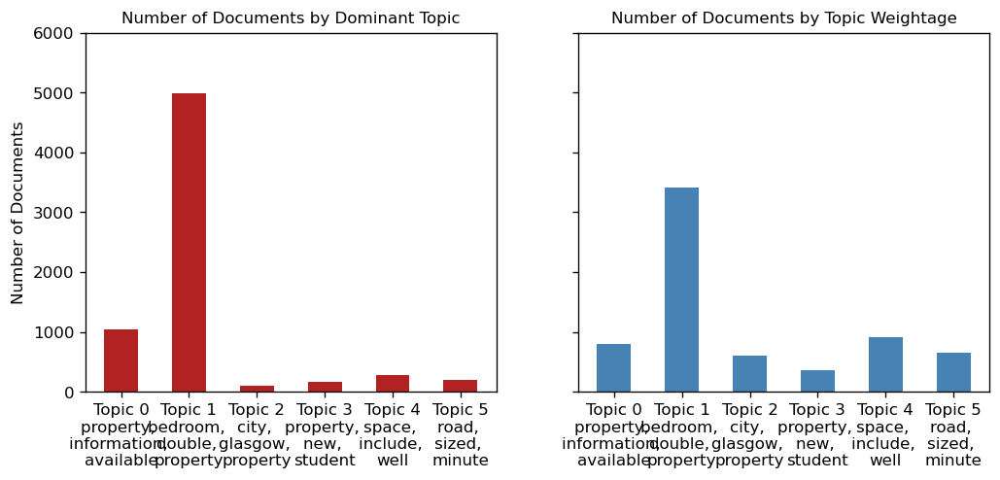

In [128]:
from matplotlib.ticker import FuncFormatter

# Plot
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(10, 4), dpi=120, sharey=True)

# Topic Distribution by Dominant Topics
ax1.bar(x='Dominant_Topic', height='count', data=df_dominant_topic_in_each_doc, width=.5, color='firebrick')
ax1.set_xticks(range(df_dominant_topic_in_each_doc.Dominant_Topic.unique().__len__()))
tick_formatter = FuncFormatter(lambda x, pos: 'Topic ' + str(x)+ '\n' + df_top3words.loc[df_top3words.topic_id==x, 'words'].values[0])
ax1.xaxis.set_major_formatter(tick_formatter)
ax1.set_title('Number of Documents by Dominant Topic', fontdict=dict(size=10))
ax1.set_ylabel('Number of Documents')
ax1.set_ylim(0, 6000)

# Topic Distribution by Topic Weights
ax2.bar(x='index', height='count', data=df_topic_weightage_by_doc, width=.5, color='steelblue')
ax2.set_xticks(range(df_topic_weightage_by_doc.index.unique().__len__()))
ax2.xaxis.set_major_formatter(tick_formatter)
ax2.set_title('Number of Documents by Topic Weightage', fontdict=dict(size=10))

plt.show()

12. t-SNE Clustering Chart

In [129]:
# Get topic weights and dominant topics
from sklearn.manifold import TSNE
from bokeh.plotting import figure, output_file, show
from bokeh.models import Label
from bokeh.io import output_notebook

# Get topic weights
topic_weights = []
for i, row_list in enumerate(lda_model[corpus]):
    topic_weights.append([w for i, w in row_list[0]])

# Array of topic weights    
arr = pd.DataFrame(topic_weights).fillna(0).values

# Keep the well separated points (optional)
arr = arr[np.amax(arr, axis=1) > 0.35]

# Dominant topic number in each doc
topic_num = np.argmax(arr, axis=1)

# tSNE Dimension Reduction
tsne_model = TSNE(n_components=2, verbose=1, random_state=0, angle=.99, init='pca')
tsne_lda = tsne_model.fit_transform(arr)

# Plot the Topic Clusters using Bokeh
output_notebook()
n_topics = 6
mycolors = np.array([color for name, color in mcolors.TABLEAU_COLORS.items()])
plot = figure(title="t-SNE Clustering of {} LDA Topics".format(n_topics), 
              plot_width=900, plot_height=700)
plot.scatter(x=tsne_lda[:,0], y=tsne_lda[:,1], color=mycolors[topic_num])
plt.savefig('t-sne.png',dpi=450)
show(plot)

[t-SNE] Computing 91 nearest neighbors...
[t-SNE] Indexed 6333 samples in 0.006s...
[t-SNE] Computed neighbors for 6333 samples in 0.123s...
[t-SNE] Computed conditional probabilities for sample 1000 / 6333
[t-SNE] Computed conditional probabilities for sample 2000 / 6333
[t-SNE] Computed conditional probabilities for sample 3000 / 6333
[t-SNE] Computed conditional probabilities for sample 4000 / 6333
[t-SNE] Computed conditional probabilities for sample 5000 / 6333
[t-SNE] Computed conditional probabilities for sample 6000 / 6333
[t-SNE] Computed conditional probabilities for sample 6333 / 6333
[t-SNE] Mean sigma: 0.000683
[t-SNE] KL divergence after 250 iterations with early exaggeration: 72.588387
[t-SNE] KL divergence after 1000 iterations: 1.071004


Loading BokehJS ...

<Figure size 640x480 with 0 Axes>

13. pyLDAVis

In [130]:
#import pyLDAvis.gensim (3.2.2 version use)
import pyLDAvis.gensim_models
# install 3.3.0 version pyLDAvis (the latest is 3.4.0)

pyLDAvis.enable_notebook()
#vis = pyLDAvis.gensim_models.prepare(lda_model, corpus, dictionary=lda_model.id2word)
vis = pyLDAvis.gensim_models.prepare(lda_model, corpus, dictionary=lda_model.id2word)

/Users/yingxu/opt/anaconda3/lib/python3.9/site-packages/pyLDAvis/_prepare.py:243: FutureWarning: In a future version of pandas all arguments of DataFrame.drop except for the argument 'labels' will be keyword-only.
  default_term_info = default_term_info.sort_values(
/Users/yingxu/opt/anaconda3/lib/python3.9/site-packages/numexpr/expressions.py:21: DeprecationWarning: distutils Version classes are deprecated. Use packaging.version instead.
  _np_version_forbids_neg_powint = LooseVersion(numpy.__version__) >= LooseVersion('1.12.0b1')
/Users/yingxu/opt/anaconda3/lib/python3.9/site-packages/numexpr/expressions.py:21: DeprecationWarning: distutils Version classes are deprecated. Use packaging.version instead.
  _np_version_forbids_neg_powint = LooseVersion(numpy.__version__) >= LooseVersion('1.12.0b1')
/Users/yingxu/opt/anaconda3/lib/python3.9/site-packages/numexpr/expressions.py:21: DeprecationWarning: distutils Version classes are deprecated. Use packaging.version instead.
  _np_version_f

In [131]:
vis

PreparedData(topic_coordinates=              x         y  topics  cluster       Freq
topic                                                
1     -0.042875  0.161788       1        1  42.910239
0     -0.283905 -0.051915       2        1  17.197080
4      0.094538  0.315656       3        1  14.512761
5      0.180210 -0.073862       4        1  10.245871
2      0.234816 -0.212194       5        1   9.182770
3     -0.182784 -0.139473       6        1   5.951279, topic_info=            Term          Freq         Total Category  logprob  loglift
65          road   3946.000000   3946.000000  Default  30.0000  30.0000
62      property  18122.000000  18122.000000  Default  29.0000  29.0000
133  information   4252.000000   4252.000000  Default  28.0000  28.0000
34       glasgow   5209.000000   5209.000000  Default  27.0000  27.0000
106         city   2901.000000   2901.000000  Default  26.0000  26.0000
..           ...           ...           ...      ...      ...      ...
282         room    431.998004   3462.309456   Topic6  -4.4715   0.7403
5           area    456.241681   4439.951289   Topic6  -4.4169   0.5462
43       kitchen    474.592332   6687.568626   Topic6  -4.3774   0.1760
229         high    285.748499    908.583810   Topic6  -4.8848   1.6648
31         fully    271.899867   2177.514771   Topic6  -4.9344   0.7411

[359 rows x 6 columns], token_table=      Topic      Freq       Term
term                            
1118      2  0.003465       able
1118      6  0.994476       able
458       2  0.002802  abundance
458       5  0.997626  abundance
0         1  0.206290     access
...     ...       ...        ...
182       4  0.548418      white
182       5  0.441339      white
339       1  0.409197     window
339       2  0.000704     window
339       3  0.590201     window

[741 rows x 3 columns], R=30, lambda_step=0.01, plot_opts={'xlab': 'PC1', 'ylab': 'PC2'}, topic_order=[2, 1, 5, 6, 3, 4])

# Determine K value of LDA

In [132]:
#for reference
zooplaa = pd.DataFrame({'id':zoopla['listing_id'].values.tolist(), 'original_d':data,'token':data_ready,'corpus':corpus})
zooplaa.head(3)

,id,original_d,token,corpus
0,60422041,Deposit Â£300 - dj Alexander present to the market this traditional one-bedroom tenement flat in...,"[present, market, traditional, bedroom, tenement, flat, highly, seek, area, available, unfurnish...","[(0, 2), (1, 1), (2, 1), (3, 1), (4, 2), (5, 1), (6, 1), (7, 1), (8, 1), (9, 1), (10, 2), (11, 1..."
1,60245623,Property Reference: 1241035.Please note: There are no more viewings available this week. Any new...,"[property, reference, note, viewing, available, week, new, enquiry, contact, property, still, av...","[(0, 1), (2, 1), (4, 1), (7, 5), (9, 2), (10, 4), (14, 1), (18, 2), (27, 1), (28, 1), (29, 2), (..."
2,59386273,"Property Reference: 1180297.We are proud to offer this delightful 2 bedroom, 2 bathroom terraced...","[property, reference, offer, delightful, bedroom, bathroom, great, location, heart, glasgow, spe...","[(0, 3), (2, 1), (7, 3), (9, 3), (10, 4), (18, 1), (26, 1), (27, 1), (29, 1), (31, 1), (32, 5), ..."


In [133]:
#calculate the reference for the value of K and plot
def format_topics_sentences(corpus, dictionary, num, texts, id_d):
    
    model = gensim.models.ldamodel.LdaModel(corpus = corpus,
                                           id2word = dictionary,
                                           num_topics = num,
                                           random_state = 100,
                                           update_every = 1,
                                           chunksize = 10,
                                           passes =10,
                                           alpha = 'symmetric',
                                           iterations = 100,
                                           per_word_topics = True)
    
    perplexity = model.log_perplexity(corpus)
    # Init output
    sent_topics_df = pd.DataFrame()
    
    # Get main topic in each document
    for i, row_list in enumerate(model[corpus]):
        row = row_list[0] if model.per_word_topics else row_list      
        row = sorted(row, key=lambda x: (x[1]), reverse=True)
        # Get the Dominant topic, Perc Contribution and Keywords for each document
        for j, (topic_num, prop_topic) in enumerate(row):
            if j == 0:  # => dominant topic
                wp = model.show_topic(topic_num,topn=30)
                topic_keywords = ", ".join([word for word, prop in wp])
                sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
            else:
                break
    sent_topics_df.columns = ['Dominant_Topic', 'Perc_Contribution', 'Topic_Keywords']

    # Add original text to the end of the output
    contents = pd.Series(texts)
    sent_topics_df = pd.concat([sent_topics_df, contents], axis=1)
    
    # Add id to the end of the output
    id_n = pd.Series(id_d)
    sent_topics_df = pd.concat([sent_topics_df, id_n], axis=1)
    
    sent_topics_df.reset_index()
    sent_topics_df.columns = ['Dominant_Topic', 'Topic_Perc_Contrib', 'Keywords', 'Text','Original_id']
    sent_topics_df.sort_values(by=['Dominant_Topic', 'Topic_Perc_Contrib'], inplace=True, ascending=False)
    
    # merge to a new list
    topic_num = n
    topic1 = []
    if len(sent_topics_df[sent_topics_df['Dominant_Topic']==0])==0:
        topic1.append(0)
        topic1.append(0)
        topic1.append(0)
        topic1.append(0)
    else:
        df = sent_topics_df[sent_topics_df['Dominant_Topic']==0].reset_index(drop=True)
        topic1.append(df.loc[0,'Dominant_Topic'])
        topic1.append(df.loc[0,'Topic_Perc_Contrib'])
        topic1.append(df.loc[0,'Keywords'])
        topic1.append(df.loc[0,'Text'])
    
    topic2 = []
    if len(sent_topics_df[sent_topics_df['Dominant_Topic']==1])==0:
        topic2.append(0)
        topic2.append(0)
        topic2.append(0)
        topic2.append(0)
    else:
        df = sent_topics_df[sent_topics_df['Dominant_Topic']==1].reset_index(drop=True)
        topic2.append(df.loc[0,'Dominant_Topic'])
        topic2.append(df.loc[0,'Topic_Perc_Contrib'])
        topic2.append(df.loc[0,'Keywords'])
        topic2.append(df.loc[0,'Text'])

    topic3 = []
    if len(sent_topics_df[sent_topics_df['Dominant_Topic']==2])==0:
        topic3.append(0)
        topic3.append(0)
        topic3.append(0)
        topic3.append(0)
    else:
        df = sent_topics_df[sent_topics_df['Dominant_Topic']==2].reset_index(drop=True)
        topic3.append(df.loc[0,'Dominant_Topic'])
        topic3.append(df.loc[0,'Topic_Perc_Contrib'])
        topic3.append(df.loc[0,'Keywords'])
        topic3.append(df.loc[0,'Text'])

    topic4 = []        
    if len(sent_topics_df[sent_topics_df['Dominant_Topic']==3])==0:
        topic4.append(0)
        topic4.append(0)
        topic4.append(0)
        topic4.append(0)
    else:
        df = sent_topics_df[sent_topics_df['Dominant_Topic']==3].reset_index(drop=True)
        topic4.append(df.loc[0,'Dominant_Topic'])
        topic4.append(df.loc[0,'Topic_Perc_Contrib'])
        topic4.append(df.loc[0,'Keywords'])
        topic4.append(df.loc[0,'Text'])

    topic5 = [] 
    if len(sent_topics_df[sent_topics_df['Dominant_Topic']==4])==0:
        topic5.append(0)
        topic5.append(0)
        topic5.append(0)
        topic5.append(0)
    else:
        df = sent_topics_df[sent_topics_df['Dominant_Topic']==4].reset_index(drop=True)
        topic5.append(df.loc[0,'Dominant_Topic'])
        topic5.append(df.loc[0,'Topic_Perc_Contrib'])
        topic5.append(df.loc[0,'Keywords'])
        topic5.append(df.loc[0,'Text'])

    topic6 = []         
    if len(sent_topics_df[sent_topics_df['Dominant_Topic']==5])==0:
        topic6.append(0)
        topic6.append(0)
        topic6.append(0)
        topic6.append(0)
    else:
        df = sent_topics_df[sent_topics_df['Dominant_Topic']==5].reset_index(drop=True)
        topic6.append(df.loc[0,'Dominant_Topic'])
        topic6.append(df.loc[0,'Topic_Perc_Contrib'])
        topic6.append(df.loc[0,'Keywords'])
        topic6.append(df.loc[0,'Text'])

    topic7 = []          
    if len(sent_topics_df[sent_topics_df['Dominant_Topic']==6])==0:
        topic7.append(0)
        topic7.append(0)
        topic7.append(0)
        topic7.append(0)
    else:
        df = sent_topics_df[sent_topics_df['Dominant_Topic']==6].reset_index(drop=True)
        topic7.append(df.loc[0,'Dominant_Topic'])
        topic7.append(df.loc[0,'Topic_Perc_Contrib'])
        topic7.append(df.loc[0,'Keywords'])
        topic7.append(df.loc[0,'Text'])

    topic8 = []          
    if len(sent_topics_df[sent_topics_df['Dominant_Topic']==7])==0:
        topic8.append(0)
        topic8.append(0)
        topic8.append(0)
        topic8.append(0)
    else:
        df = sent_topics_df[sent_topics_df['Dominant_Topic']==7].reset_index(drop=True)
        topic8.append(df.loc[0,'Dominant_Topic'])
        topic8.append(df.loc[0,'Topic_Perc_Contrib'])
        topic8.append(df.loc[0,'Keywords'])
        topic8.append(df.loc[0,'Text'])
    
    alist = [topic_num, perplexity, topic1, topic2, topic3, topic4, topic5, topic6, topic7, topic8]
    return(alist, sent_topics_df)

Alists = []
for n in range(4,9):
    
    Alist, sent= format_topics_sentences(corpus=corpus, dictionary=id2word, num=n, texts=data, id_d=(zooplaa['id'].values.tolist())) #用以检查不同模型的匹配情况

    a = Alist[2:(n+6)]
    a.sort(key=lambda x:x[1],reverse=True)
    Alists.append((Alist[:2]+a+Alist[6+n:]))
    print(sent.groupby('Dominant_Topic').count())
        
    
print(Alists[0])

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

                Topic_Perc_Contrib  Keywords  Text  Original_id
Dominant_Topic                                                 
0                             1011      1011  1011         1011
1                             4675      4675  4675         4675
2                              972       972   972          972
3                              113       113   113          113


/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

                Topic_Perc_Contrib  Keywords  Text  Original_id
Dominant_Topic                                                 
0                             1040      1040  1040         1040
1                             3933      3933  3933         3933
2                              292       292   292          292
3                               94        94    94           94
4                             1412      1412  1412         1412


/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

                Topic_Perc_Contrib  Keywords  Text  Original_id
Dominant_Topic                                                 
0                             1037      1037  1037         1037
1                             4993      4993  4993         4993
2                              106       106   106          106
3                              169       169   169          169
4                              272       272   272          272
5                              194       194   194          194


/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

                Topic_Perc_Contrib  Keywords  Text  Original_id
Dominant_Topic                                                 
0                                2         2     2            2
1                             2722      2722  2722         2722
2                               56        56    56           56
3                             1557      1557  1557         1557
4                             1364      1364  1364         1364
6                             1070      1070  1070         1070


/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

                Topic_Perc_Contrib  Keywords  Text  Original_id
Dominant_Topic                                                 
0                              170       170   170          170
1                              163       163   163          163
3                               99        99    99           99
4                             5216      5216  5216         5216
5                                3         3     3            3
6                             1042      1042  1042         1042
7                               78        78    78           78
[4, -6.01857313396685, [0, 0.9944, 'property, information, available, contact, number, landlord, view, reference, pet, fee, tenant, rent, register, month, day, book, scottish, week, bill, form, deposit, bedroom, student, access, openrent, require, bathroom, registration, detail, call', 'Property Reference: 1050959.We are proud to offer this delightful 3 bedroom, 1 bathroom flat in a great location.Available to move in fr

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

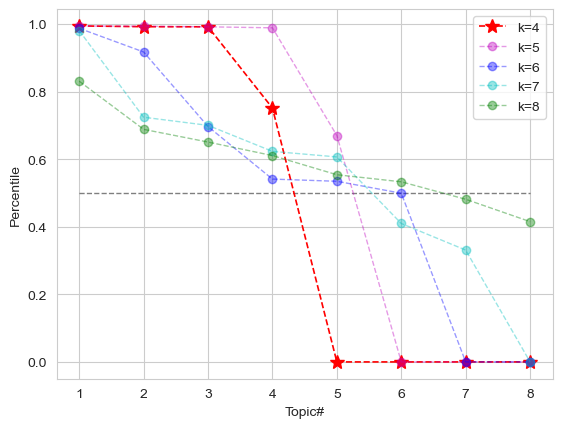

In [105]:
import matplotlib.pyplot as plt

x = [1,2,3,4,5,6,7,8]
c_s = ['r*--','mo--','bo--','co--','go--']

plt.plot(x,[0.5,0.5,0.5,0.5,0.5,0.5,0.5,0.5],'k--',alpha=0.5, linewidth=1)
for i in range(5):
    if i>0:
        alpha = 0.4
        l_w  = 1
        m_s = 6
    else:
        alpha = 1
        l_w  = 1.2
        m_s = 10
    label_s = 'k='+str(4+i)
    y = []
    for j in range(8):
        y.append(Alists[i][2+j][1])
    plt.plot(x, y, c_s[i], markersize = m_s, linewidth=l_w,alpha = alpha, label=label_s)

# plt.title('I NEED A TITLE') 
plt.legend()
plt.xlabel('Topic#')
plt.ylabel('Percentile')
plt.savefig('kvalue.png',dpi=450)


# Topics extraction

In [168]:
# Concert to list
data = zoopla['description'].values.tolist()

zooplaa = pd.DataFrame({'listing_id':zoopla['listing_id'].values.tolist(),
                        'lon':zoopla['lon'],
                        'lat':zoopla['lat'],
                        'token':data_ready,
                        'corpus':corpus})

#identify the theme of each description
Alist, sent= format_topics_sentences(corpus=corpus, 
                                     dictionary=id2word, 
                                     num=6, 
                                     texts=data, 
                                     id_d=(zooplaa['listing_id'].values.tolist())) #Used to check the matching of different models

sent = sent.rename(columns={'Original_id':'listing_id'})

# merge to a new dataset
zoopla_result = pd.merge(zooplaa, sent, how='left', on='listing_id')

# change the values in the 'Dominant_Topic' variable:
zoopla_result['Dominant_Topic'] = zoopla_result['Dominant_Topic'].replace([0],'Property Structure')
zoopla_result['Dominant_Topic'] = zoopla_result['Dominant_Topic'].replace([1],'Contact Information')
zoopla_result['Dominant_Topic'] = zoopla_result['Dominant_Topic'].replace([2],'Property Facilities')
zoopla_result['Dominant_Topic'] = zoopla_result['Dominant_Topic'].replace([3],'Property Location')
zoopla_result['Dominant_Topic'] = zoopla_result['Dominant_Topic'].replace([4],'Property Amenities')
zoopla_result['Dominant_Topic'] = zoopla_result['Dominant_Topic'].replace([5],'Student Accommodation')

# Export cleaned data + LDA
zoopla_result.to_csv("../Final/result_Zoopla.csv", index=False, index_label=False)

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
/var/folders/mc/ng5970r574q0c79w98x03sz80000gn/T/ipykernel_3193/4205273872.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords

In [169]:
zoopla_result.Dominant_Topic.value_counts()

Contact Information      4993
Property Structure       1037
Property Amenities        272
Student Accommodation     194
Property Location         169
Property Facilities       106
Name: Dominant_Topic, dtype: int64